In [16]:
import cv2 
from matplotlib import pyplot as plt
import numpy as np
import math

In [17]:
# Creates the kernels
def getGaussianKernels(size, sigma = 1):
    kernel = [[0] * size for _ in range(size)]
    center = size // 2

    total = 0
    for x in range(size):
        for y in range(size):
            kernel[x][y] = math.exp(-((x - center)**2 + (y - center)**2) / (2 * sigma**2))
            total += kernel[x][y]

    # Normalize the kernel
    for x in range(size):
        for y in range(size):
            kernel[x][y] /= total

    print(kernel)

    return kernel

In [18]:
def importImages(name):

    image_info = {}
    
    # original_image = cv2.imread('cameraman.jpg')
    noisy_image = cv2.imread(name)


    # cv2.imshow('Image1', original_image)
#     cv2.imshow('Input', noisy_image)

    height, width, channels = noisy_image.shape


    image_info['height'] = height
    image_info['width'] = width
    image_info['channels'] = channels
    image_info['image'] = noisy_image # list of list image values


    noisy_image = cv2.cvtColor(noisy_image, cv2.COLOR_BGR2GRAY)
    image_info['bw_image'] = noisy_image #single string image
    
    return image_info


In [19]:
def buildImage(pixel_values, dimension):

    image_array = np.array(pixel_values).reshape((dimension, dimension))

    image_array = np.uint8(image_array)

    # Create the image using cv2
    final_image = cv2.resize(image_array, (dimension, dimension), interpolation=cv2.INTER_NEAREST)

    # Display the image
    # cv2.imshow('original input', original_image)
#     cv2.imshow('black and white input', bw_image)
#     cv2.imshow('Output', final_image)
#     cv2.waitKey(0)
#     cv2.destroyAllWindows()

    return final_image

In [20]:
#print images: 
def printImages(original_image, final_image): 
    
    plt.figure(figsize=(12, 12))  # Set the size of the figure

    plt.subplot(1, 2, 1)  # 1 row, 2 columns, plot number 1
    plt.imshow(original_image, cmap='gray')
    plt.axis('off')  # Turn off axis
    plt.title('Original Image')
    
    plt.subplot(1, 2, 2)  # 1 row, 2 columns, plot number 2
    plt.imshow(final_image, cmap='gray')
    plt.axis('off')  # Turn off axis
    plt.title('Final Image')

In [21]:
import numpy as np
import pandas as pd


def create_kernel_txt(kernel):
   
   with open('kernel.txt', 'w') as f:
        for row in kernel:
            line = ' '.join(str(item) for item in row)
            f.write(line + '\n')



def create_image_txt(image):
    with open('image.txt', 'w') as f:
        for row in image:
            line = ' '.join(str(item) for item in row)
            f.write(line + '\n')  



def create_size_txt(size):
    with open('size.txt', 'w') as f:
            f.write(str(size))



def create_kernelsize_txt(kernel_size):
    with open('kernel_size.txt', 'w') as f:
        f.write(str(kernel_size))


def extract_txt(output_filename, mat_size):
    with open(output_filename, "r") as file:
        data = file.read()

    # Split the string by newlines to get the rows
    rows = data.split("\n")

    # Split each row by spaces to get the numbers, and convert to integers
    matrix = [list(map(int, row.replace(',', ' ').split())) for row in rows if row]

    # Convert the list of lists to a NumPy array and reshape to the specified dimensions
    output_image = np.array(matrix).reshape(mat_size, mat_size)

    return output_image

In [34]:
image_info = importImages('barb_noisy.jpg')

kernel_size = 11 # 1

image_info["kernel"] = getGaussianKernels(kernel_size, 1)

size  = image_info["height"] # 2
image = image_info["bw_image"] # 3
kernel_mat = image_info["kernel"] # 4


[[2.210334945638408e-12, 1.9896801101966426e-10, 6.588915610238256e-09, 8.026942462931238e-08, 3.597426030435144e-07, 5.931152816148748e-07, 3.597426030435144e-07, 8.026942462931238e-08, 6.588915610238256e-09, 1.9896801101966426e-10, 2.210334945638408e-12], [1.9896801101966426e-10, 1.791052957256079e-08, 5.931152816148748e-07, 7.225623336274153e-06, 3.2382997132559535e-05, 5.339053618147216e-05, 3.2382997132559535e-05, 7.225623336274153e-06, 5.931152816148748e-07, 1.791052957256079e-08, 1.9896801101966426e-10], [6.588915610238256e-09, 5.931152816148748e-07, 1.964128061428365e-05, 0.00023927978246399278, 0.0010723775858217462, 0.001768051735966365, 0.0010723775858217462, 0.00023927978246399278, 1.964128061428365e-05, 5.931152816148748e-07, 6.588915610238256e-09], [8.026942462931238e-08, 7.225623336274153e-06, 0.00023927978246399278, 0.002915024504786033, 0.013064233462867194, 0.021539279595621536, 0.013064233462867194, 0.002915024504786033, 0.00023927978246399278, 7.225623336274153e-06,

In [35]:
create_image_txt(image)
create_kernel_txt(kernel_mat)
create_size_txt(size)
create_kernelsize_txt(kernel_size)

In [36]:
!g++ gaussian_blur_c.cpp -o gauss
!./gauss

gaussian_blur_c.cpp:49:5: warning: 'auto' type specifier is a C++11 extension [-Wc++11-extensions]
    auto start = std::chrono::high_resolution_clock::now();
    ^
gaussian_blur_c.cpp:255:5: warning: 'auto' type specifier is a C++11 extension [-Wc++11-extensions]
    auto end = std::chrono::high_resolution_clock::now();
    ^
2 warnings generated.
Pixel 1, 1 finished; val = 58
Pixel 1, 2 finished; val = 88
Pixel 1, 3 finished; val = 110
Pixel 1, 4 finished; val = 112
Pixel 1, 5 finished; val = 98
Pixel 1, 6 finished; val = 84
Pixel 1, 7 finished; val = 74
Pixel 1, 8 finished; val = 68
Pixel 1, 9 finished; val = 62
Pixel 1, 10 finished; val = 69
Pixel 1, 11 finished; val = 64
Pixel 1, 12 finished; val = 65
Pixel 1, 13 finished; val = 63
Pixel 1, 14 finished; val = 59
Pixel 1, 15 finished; val = 57
Pixel 1, 16 finished; val = 50
Pixel 1, 17 finished; val = 36
Pixel 1, 18 finished; val = 50
Pixel 1, 19 finished; val = 54
Pixel 1, 20 finished; val = 50
Pixel 1, 21 finished; val = 49
Pixel

In [25]:
"""
This function will be converted to C++ using the AXI stream interface and loop fission optimization to be executing in
Vitis HLS
"""

import time

def gaussianBlur(image, kernel):
        
    down = 0 #determines what the kernel can compute. 
    up = 0
    right = 0 
    left = 0
    kernel_center = int((len(kernel) - 1)/2)

    new_image = []
    for row in range(len(image)):

        new_row = []

        for col in range(len(image[row])):
            
            # reinitializes the value of the sum to 0
            sum = 0

            # center
            sum += (kernel[kernel_center][kernel_center] * image[row][col])

            # check down
            if((row + 1) >= len(image)):
                down = 0 
            else:
                for i in range(kernel_center, 0-1, -1):
                    if (row + i < len(image)):
                        down = i
                        break
                for i in range(down):
                    sum += (kernel[kernel_center + i + 1][kernel_center] * image[row + i + 1][col])
                

            # check up
            if((row - 1) < 0):
                up = 0
            else:
                for i in range(kernel_center, 0-1, -1):
                    if (row - i >= 0):
                        up = i
                        break
                for i in range(up):
                    sum += (kernel[kernel_center - i - 1][kernel_center] * image[row - i - 1][col])


            # check right
            if((col+1) >= len(image[row])):
                right = 0
            else:
                for i in range(kernel_center, 0-1, -1):
                    if (col + i < len(image[row])):
                        right = i
                        break
                for i in range(right):
                    sum += (kernel[kernel_center][kernel_center + i + 1] * image[row][col + i + 1])


            # check left
            if((col-1) < 0):
                left = 0
            else:
                for i in range(kernel_center, 0-1, -1):
                    if((col - i) >= 0):
                        left = i
                        break
                for i in range(left):
                    sum += (kernel[kernel_center][kernel_center - i - 1] * image[row][col - i - 1])


            #bottom right square 
            if (down > 0) and (right > 0):
                for i in range(down):
                    for j in range(right):
                        sum += (kernel[kernel_center + i + 1][kernel_center + j + 1] * image[row + i + 1][col + j + 1])


            #bottom left square 
            if (down > 0) and (left > 0):
                for i in range(down):
                    for j in range(left):
                        sum += (kernel[kernel_center + i + 1][kernel_center - j - 1] * image[row + i + 1][col - j - 1])


            #top right square 
            if (up > 0) and (right > 0):
                for i in range(up):
                    for j in range(right):
                        sum += (kernel[kernel_center - i - 1][kernel_center + j + 1] * image[row - i - 1][col + j + 1])


            #top left square 
            if (up > 0) and (left > 0):
                for i in range(up):
                    for j in range(left):
                        sum += (kernel[kernel_center - i - 1][kernel_center - j - 1] * image[row - i - 1][col - j - 1])


            
            new_row.append(sum) # per column
            del sum

            print("pixel " + str(row) + " " + str(col) + " complete")


        new_image.append(new_row) # per row
        del new_row


512
512
[[      58       88      110 ...       57       58       44]
 [      63       94      116 ...       80       76       57]
 [      53       74       85 ...       94       78       49]
 ...
 [      28       39       39 ...       86       87       65]
 [      21       31       28 ...       92       96       57]
 [      10       16       23 ...   347342  5194602 35910016]]


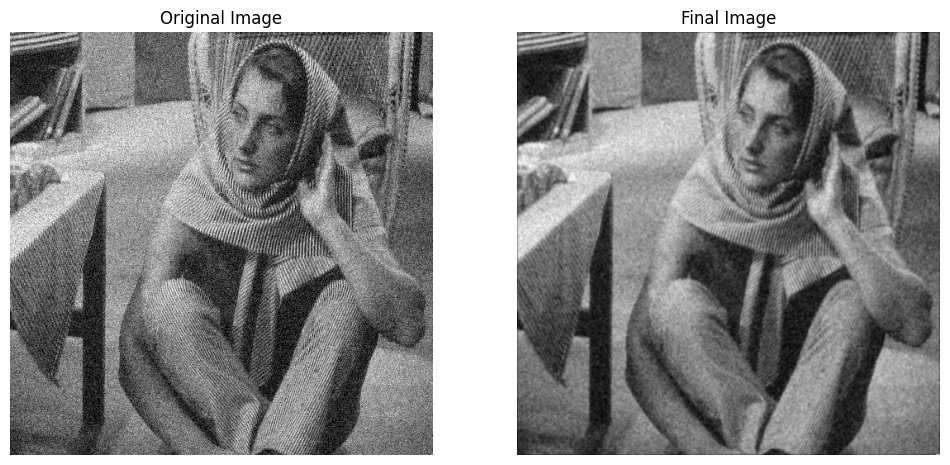

In [37]:
final_image = extract_txt('output.txt', size)

print(len(final_image))
print(len(final_image[0]))
print(final_image)

printable_image = buildImage(final_image, size)
printImages(image ,printable_image)

In [27]:
start = time.time()
gaussianBlur(image, kernel_mat)
stop = time.time()

pixel 0 0 complete
pixel 0 1 complete
pixel 0 2 complete
pixel 0 3 complete
pixel 0 4 complete
pixel 0 5 complete
pixel 0 6 complete
pixel 0 7 complete
pixel 0 8 complete
pixel 0 9 complete
pixel 0 10 complete
pixel 0 11 complete
pixel 0 12 complete
pixel 0 13 complete
pixel 0 14 complete
pixel 0 15 complete
pixel 0 16 complete
pixel 0 17 complete
pixel 0 18 complete
pixel 0 19 complete
pixel 0 20 complete
pixel 0 21 complete
pixel 0 22 complete
pixel 0 23 complete
pixel 0 24 complete
pixel 0 25 complete
pixel 0 26 complete
pixel 0 27 complete
pixel 0 28 complete
pixel 0 29 complete
pixel 0 30 complete
pixel 0 31 complete
pixel 0 32 complete
pixel 0 33 complete
pixel 0 34 complete
pixel 0 35 complete
pixel 0 36 complete
pixel 0 37 complete
pixel 0 38 complete
pixel 0 39 complete
pixel 0 40 complete
pixel 0 41 complete
pixel 0 42 complete
pixel 0 43 complete
pixel 0 44 complete
pixel 0 45 complete
pixel 0 46 complete
pixel 0 47 complete
pixel 0 48 complete
pixel 0 49 complete
pixel 0 50

In [28]:
print('time elapsed: ' + str((stop-start)) + ' seconds')

time elapsed: 23.372706174850464 seconds
